<a href="https://colab.research.google.com/github/harisgulzar1/RoadDistressAnalysis/blob/main/Road_Distress_Detection_Image_Classification_resnet50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Introduction



---



In [1]:
#magic function for matplotlib graphs. Graphs will be included in notebook next to the code.
%matplotlib inline

In [2]:
#importing dependencies
from __future__ import print_function, division

from datetime import datetime
from PIL import Image
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torchvision.transforms as T
from torchvision.transforms import ToTensor
import matplotlib.pyplot as plt
import time
import os
import copy

plt.ion()   # interactive mode

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image

def extract_label(image_name):
    # Split the image name string by dot to get the part before the underscore
    parts = image_name.split('.')

    if len(parts) > 1:
        # Split the part before the underscore by underscore to get the label
        label_parts = parts[1].split('_')

        # Return the first element of the label parts
        return label_parts[0]
    else:
        return None

class CustomDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_paths = []
        self.labels = []

        # Iterate through all files in the root directory
        for filename in os.listdir(root_dir):
            if filename.endswith(".jpg") or filename.endswith(".png"):  # Assuming images are jpg or png
                # Extract label from filename
                label = extract_label(filename)
                if label in ['MS-RAVEL', 'MS-POTHOLE', 'HS-POTHOLE', 'HS-RAVEL']:  # Add only relevant labels
                    self.image_paths.append(os.path.join(root_dir, filename))
                    self.labels.append(label)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        label = self.labels[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return image, label

# Define transformations for the images
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Define root directory of images
root_dir = '/content/drive/MyDrive/AItraining2data/extractedimages/Image/'

# Create custom dataset
custom_dataset = CustomDataset(root_dir=root_dir, transform=transform)

# Create data loader
data_loader = DataLoader(custom_dataset, batch_size=32, shuffle=True)

# Example usage of data loader
for images, labels in data_loader:
    # Process batch of images and labels
    print(images.shape, labels)


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/AItraining2data/extractedimages/Image/'

Load Data
---------


In [6]:
#Dataset from drive
DATA_FILE = "/content/drive/MyDrive/AItraining2data/APD"
train_dataset = "/content/drive/MyDrive/AItraining2data/APD/Train/"
val_dataset = "/content/drive/MyDrive/AItraining2data/APD/Validation/"

#Data transformation

In [7]:
#changing the format and structure of the data.
data_transforms = {
    'Train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'Validation': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

data_dir = DATA_FILE
data_types = ['Train', 'Validation']
image_datasets = {x: datasets.ImageFolder(os.path.join(data_dir, x),
                                          data_transforms[x])
                  for x in data_types}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4,
                                             shuffle=True, num_workers=4)
              for x in data_types}
dataset_sizes = {x: len(image_datasets[x]) for x in data_types}
class_names = image_datasets['Train'].classes

#checking for available processor
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


# Data Visualization

With the help of data visualization, we can see how the data looks and what we are dealing with from the image.



In [8]:
print("List of Directories:", os.listdir(data_dir))
classes = os.listdir(data_dir + "/Train")
print("List of classes:", classes)

List of Directories: ['Train', 'Validation']
List of classes: ['Fatigue cracks', 'Linear cracks', 'Potholes']


In [9]:
image_size = 300
batch_size = 128

In [10]:
train_dataset = ImageFolder(data_dir+'/Train', transform=ToTensor())
val_dataset = ImageFolder(data_dir+'/Validation', transform=ToTensor())

In [11]:
train_dataset = ImageFolder(data_dir + '/Train', transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor()]))

val_dataset = ImageFolder(data_dir + '/Validation', transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor()]))

In [12]:
img, label = val_dataset[2]
print(img.shape, label)
img

torch.Size([3, 300, 300]) 0


tensor([[[0.5647, 0.5686, 0.5294,  ..., 0.6078, 0.6118, 0.5922],
         [0.5373, 0.5451, 0.5020,  ..., 0.5843, 0.5961, 0.5725],
         [0.4941, 0.5059, 0.4667,  ..., 0.5490, 0.5725, 0.5490],
         ...,
         [0.4784, 0.5529, 0.5608,  ..., 0.4706, 0.4902, 0.4784],
         [0.5059, 0.5647, 0.5647,  ..., 0.4941, 0.4196, 0.4392],
         [0.5255, 0.5725, 0.5647,  ..., 0.5059, 0.3725, 0.4118]],

        [[0.5647, 0.5686, 0.5294,  ..., 0.6118, 0.6157, 0.5961],
         [0.5373, 0.5451, 0.5020,  ..., 0.5882, 0.6000, 0.5765],
         [0.4941, 0.5059, 0.4667,  ..., 0.5529, 0.5765, 0.5529],
         ...,
         [0.4745, 0.5490, 0.5569,  ..., 0.4667, 0.4863, 0.4745],
         [0.4980, 0.5569, 0.5569,  ..., 0.4902, 0.4157, 0.4353],
         [0.5176, 0.5647, 0.5569,  ..., 0.5020, 0.3686, 0.4078]],

        [[0.6039, 0.6078, 0.5608,  ..., 0.6314, 0.6353, 0.6157],
         [0.5765, 0.5804, 0.5373,  ..., 0.6078, 0.6196, 0.5961],
         [0.5333, 0.5412, 0.5020,  ..., 0.5725, 0.5961, 0.

In [14]:
import matplotlib.pyplot as plt

def show_example(img, label):
    print('Label: ', train_dataset.classes[label], "("+str(label)+")")
    plt.imshow(img.permute(1, 2, 0))

Label:  Fatigue cracks (0)


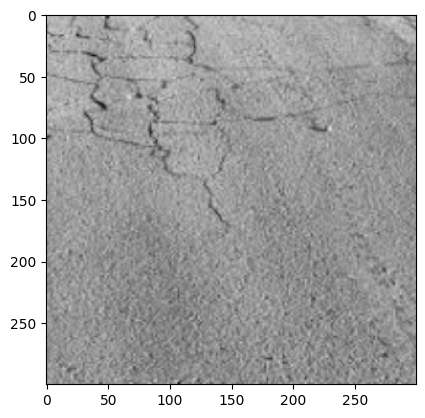

In [15]:
show_example(*train_dataset[56])

Label:  Linear cracks (1)


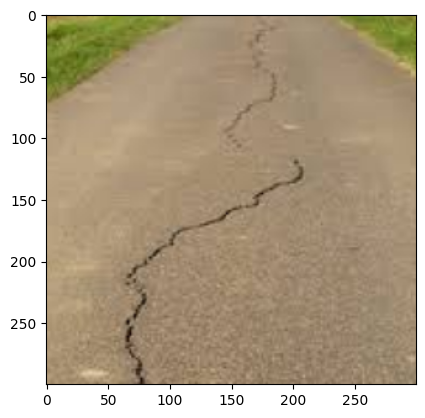

In [16]:
import random
random_value = random.randint(1000, 2000)
show_example(*train_dataset[random_value])

Label:  Linear cracks (1)


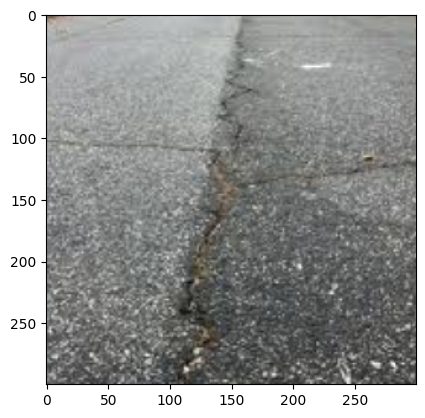

In [17]:
random_value = random.randint(800, 900)
show_example(*train_dataset[random_value])

Label:  Fatigue cracks (0)


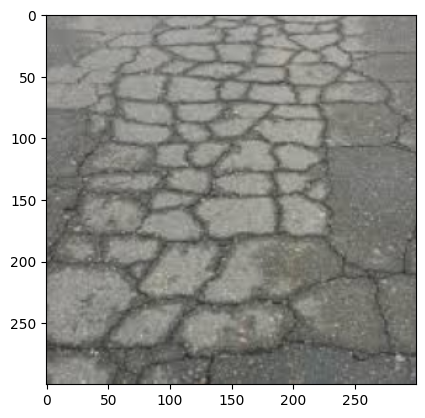

In [18]:
random_value = random.randint(200, 300)
show_example(*train_dataset[random_value])

643
Label:  Fatigue cracks (0)


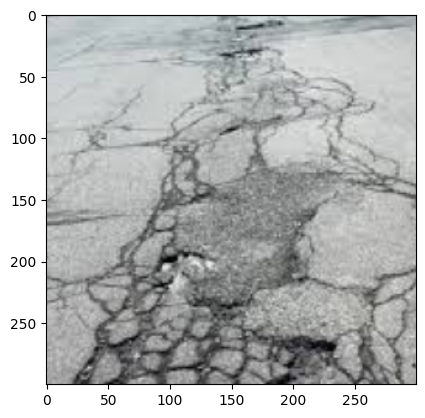

In [19]:
random_value = random.randint(550, 650)
print(random_value)
show_example(*train_dataset[random_value])

In [20]:
new_batch_size = 12
train_dl = DataLoader(train_dataset, new_batch_size, shuffle=True, num_workers=4, pin_memory=True)
val_dl = DataLoader(val_dataset, new_batch_size*2, num_workers=4, pin_memory=True)

In [21]:
from torchvision.utils import make_grid

def show_batch(dl):
    for images, labels in dl:
        fig, ax = plt.subplots(figsize=(18, 12))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(images, nrow=4).permute(1, 2, 0))
        break

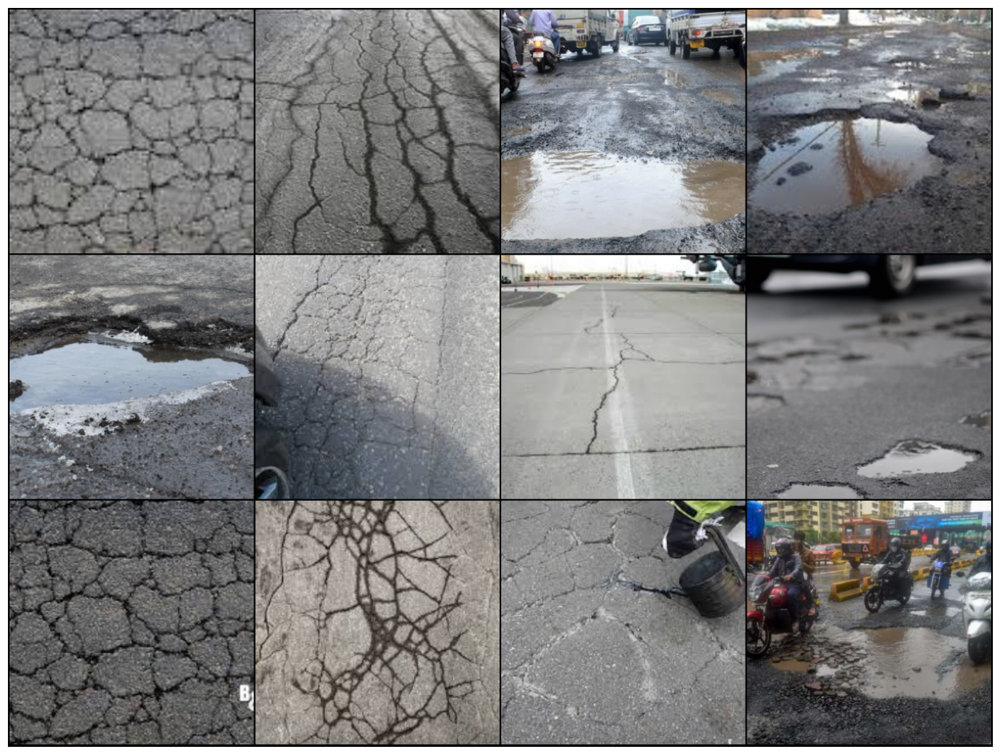

In [22]:
show_batch(train_dl)


#Tensorboarding

In [23]:
#tensorboard logging
#to track various metrics such as accuracy and log loss on training or validation set
from torch.utils.tensorboard import SummaryWriter

TB_DIR = f'runs/exp_{datetime.now().strftime("%Y%m%d-%H%M%S")}'
tb_train_writer = SummaryWriter(f'{TB_DIR}/Train')
tb_val_writer = SummaryWriter(f'{TB_DIR}/Validation')

%load_ext tensorboard

#Model Building


Helper function for training the model

In [24]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=4):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['Train', 'Validation']:
            if phase == 'Train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'Train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'Train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'Train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            if phase == 'Train':
              tb_writer = tb_train_writer
            else:
              tb_writer = tb_val_writer

            tb_writer.add_scalar(f'Loss', epoch_loss, epoch)
            tb_writer.add_scalar(f'Accuracy', epoch_acc, epoch)

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # deep copy the model
            if phase == 'Validation' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    tb_train_writer.close()
    tb_val_writer.close()

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

## Visualizing Predictions



In [25]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [26]:
def visualize_model(model, dataset, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders[dataset]):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

##Finetuning the Convnet
----------------------
Load a pretrained model and reset final fully connected layer.


In [27]:
model_ft = models.resnet50(pretrained=True)
num_ftrs = model_ft.fc.in_features
# Here the size of each output sample is set to number of classes.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model_ft.fc = nn.Linear(num_ftrs, len(class_names))

model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 131MB/s]


## Training and evaluation




In [28]:
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=32)

Epoch 0/31
----------


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Train Loss: 0.7176 Acc: 0.7331
Validation Loss: 0.4268 Acc: 0.8631

Epoch 1/31
----------
Train Loss: 0.5714 Acc: 0.7946
Validation Loss: 0.3923 Acc: 0.8614

Epoch 2/31
----------
Train Loss: 0.3820 Acc: 0.8545
Validation Loss: 0.3409 Acc: 0.8781

Epoch 3/31
----------
Train Loss: 0.3271 Acc: 0.8871
Validation Loss: 0.2739 Acc: 0.8982

Epoch 4/31
----------
Train Loss: 0.2978 Acc: 0.9063
Validation Loss: 0.3513 Acc: 0.8848

Epoch 5/31
----------
Train Loss: 0.2362 Acc: 0.9246
Validation Loss: 0.3497 Acc: 0.8865

Epoch 6/31
----------
Train Loss: 0.1904 Acc: 0.9311
Validation Loss: 0.3242 Acc: 0.8948

Epoch 7/31
----------
Train Loss: 0.1579 Acc: 0.9491
Validation Loss: 0.2854 Acc: 0.9048

Epoch 8/31
----------
Train Loss: 0.1231 Acc: 0.9637
Validation Loss: 0.3346 Acc: 0.8848

Epoch 9/31
----------
Train Loss: 0.1105 Acc: 0.9645
Validation Loss: 0.3076 Acc: 0.8998

Epoch 10/31
----------


KeyboardInterrupt: 

#Showing TensorBoard for metrices learnt

In [29]:
%tensorboard --logdir='./runs'

<IPython.core.display.Javascript object>

In [32]:
# Load model weights
model_path = '/content/drive/MyDrive/AItraining2data/model-APD-pytorch-res50-92accuracy.pt'
model_ft = torch.load(model_path)
# model_ft.load_state_dict(checkpoint['model_state_dict'])


# Model Testing

In [33]:
def check_accuracy(test_loader, model, device):
    num_correct = 0
    total = 0
    model.eval()

    with torch.no_grad():
        for data, labels in test_loader:
            data = data.to(device=device)
            labels = labels.to(device=device)

            outputs = model(data)
            _, predictions = torch.max(outputs, 1)
            num_correct += (predictions == labels).sum()
            total += labels.size(0)
        print(f"Test Accuracy of the model: {float(num_correct)/float(total):.2f}")

def visualize_test_errors(test_loader, model, device):
    model.eval()
    incorrect_examples=[]

    with torch.no_grad():
        for data, labels in test_loader:
            data = data.to(device=device)
            labels = labels.to(device=device)

            outputs = model(data)
            _, predictions = torch.max(outputs, 1)
            idxs_mask = (predictions != labels).view(-1)
            num_true_idxs = idxs_mask.sum()
            if num_true_idxs > 0:
                found_falses = data[idxs_mask].cpu().numpy()
                false_predictions = predictions[idxs_mask].cpu().numpy()
                false_labels = labels[idxs_mask].cpu().numpy()
                for j in range(found_falses.shape[0]):
                    incorrect_examples.append((found_falses[j,:,:,:],
                                               false_predictions[j],
                                               false_labels[j]))
    return incorrect_examples

def show_image(inp, title=None):
    inp = inp.transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

def visualize_error_images(error_examples):
    for img, prediction, label in error_examples:
        print(f'gt label: {class_names[label]}')
        print(f'prediction: {class_names[prediction]}')
        show_image(img.squeeze())


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Test Accuracy of the model: 0.92
gt label: Linear cracks
prediction: Fatigue cracks


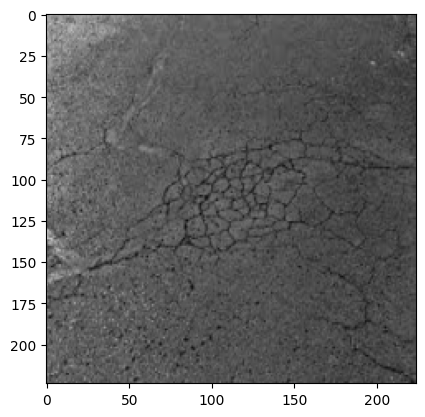

gt label: Linear cracks
prediction: Fatigue cracks


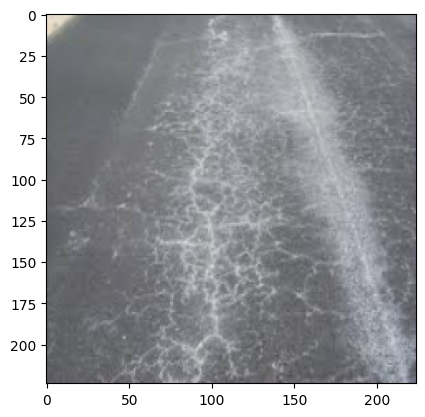

gt label: Fatigue cracks
prediction: Linear cracks


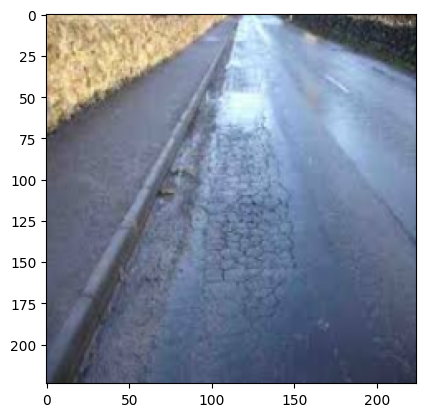

gt label: Fatigue cracks
prediction: Linear cracks


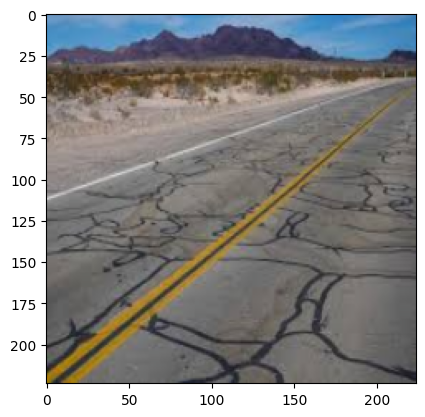

gt label: Fatigue cracks
prediction: Potholes


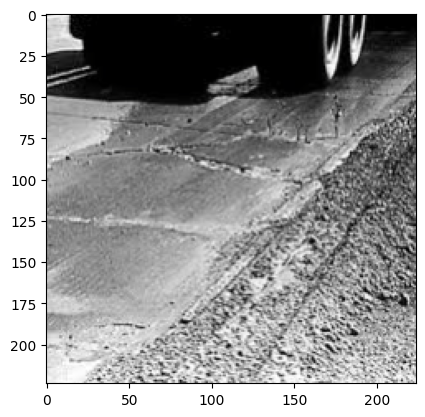

gt label: Fatigue cracks
prediction: Linear cracks


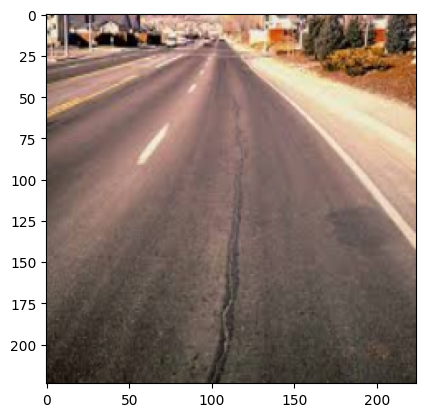

gt label: Fatigue cracks
prediction: Potholes


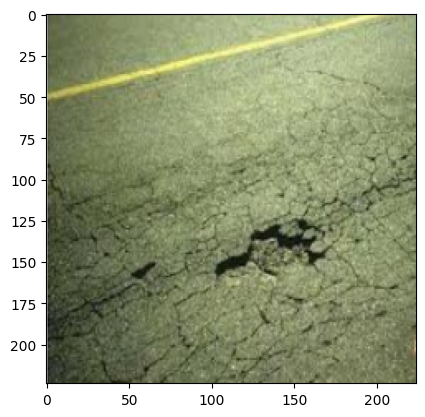

gt label: Linear cracks
prediction: Fatigue cracks


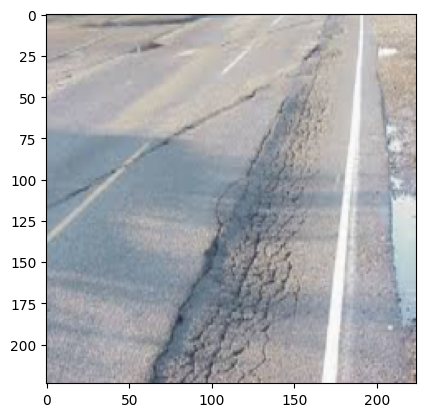

gt label: Linear cracks
prediction: Fatigue cracks


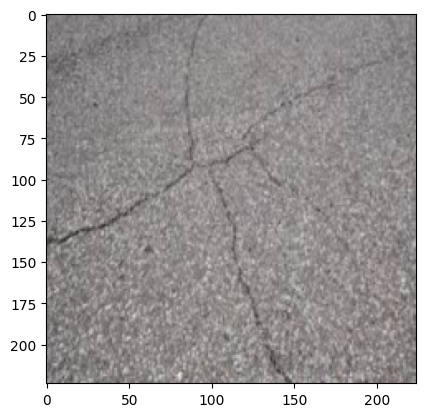

gt label: Fatigue cracks
prediction: Linear cracks


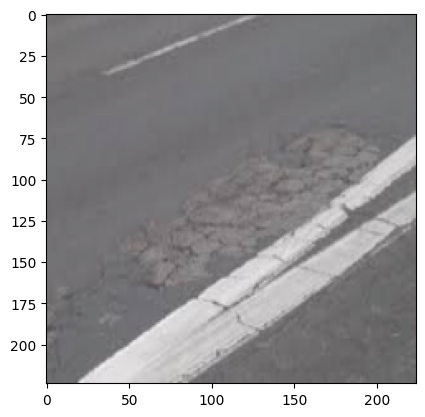

gt label: Fatigue cracks
prediction: Linear cracks


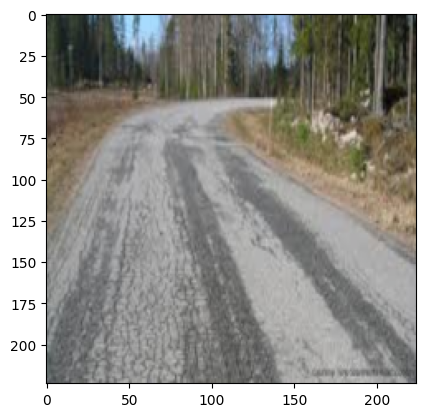

gt label: Fatigue cracks
prediction: Linear cracks


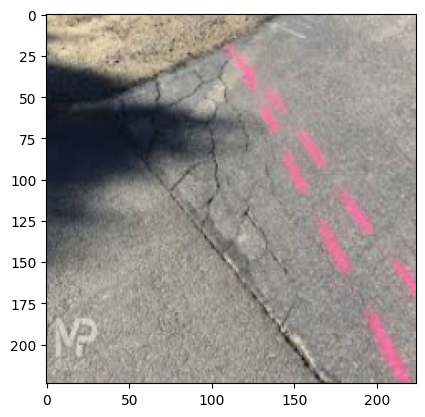

gt label: Fatigue cracks
prediction: Linear cracks


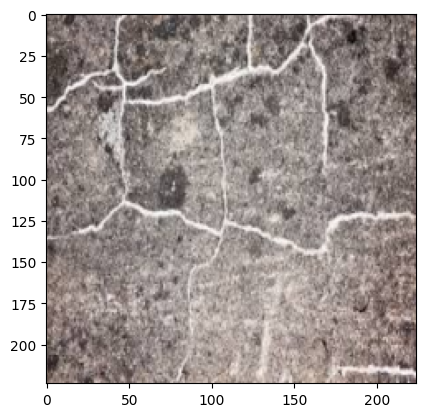

gt label: Fatigue cracks
prediction: Linear cracks


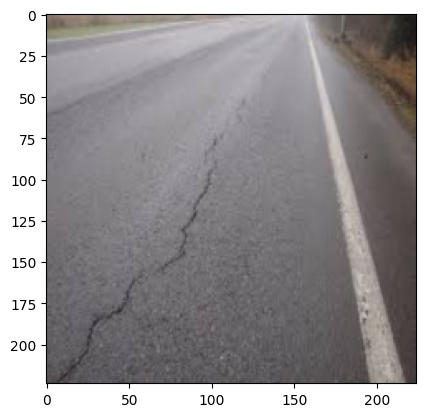

gt label: Fatigue cracks
prediction: Linear cracks


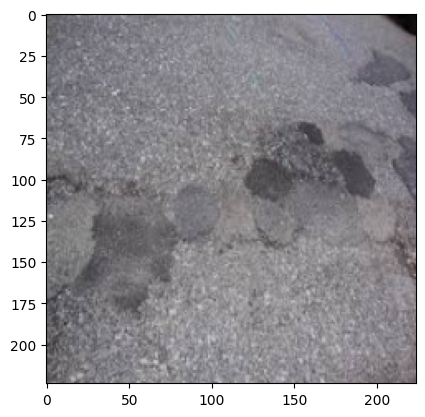

gt label: Linear cracks
prediction: Fatigue cracks


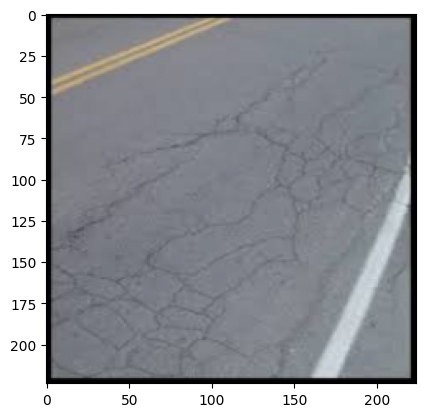

gt label: Linear cracks
prediction: Fatigue cracks


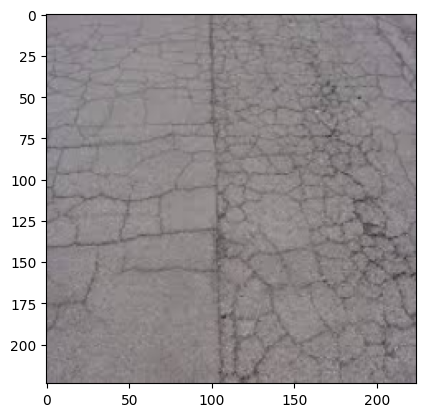

gt label: Linear cracks
prediction: Fatigue cracks


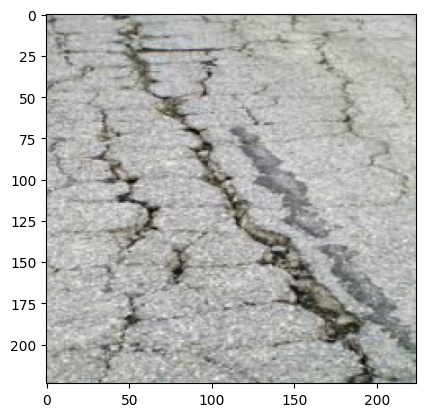

gt label: Linear cracks
prediction: Fatigue cracks


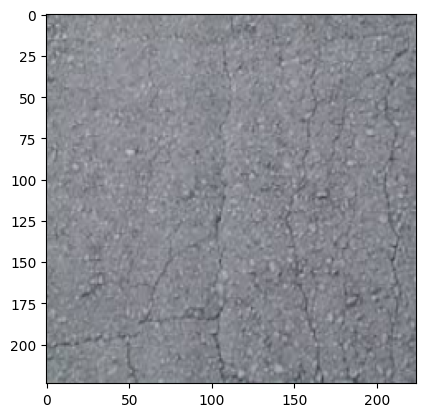

gt label: Linear cracks
prediction: Fatigue cracks


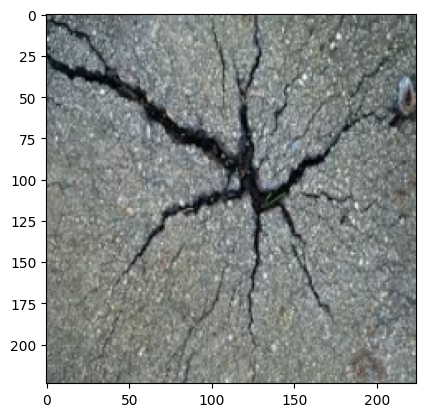

gt label: Fatigue cracks
prediction: Linear cracks


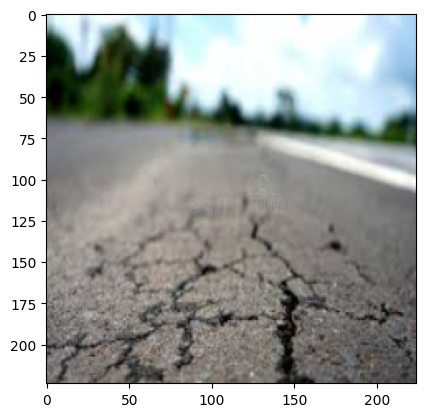

gt label: Fatigue cracks
prediction: Linear cracks


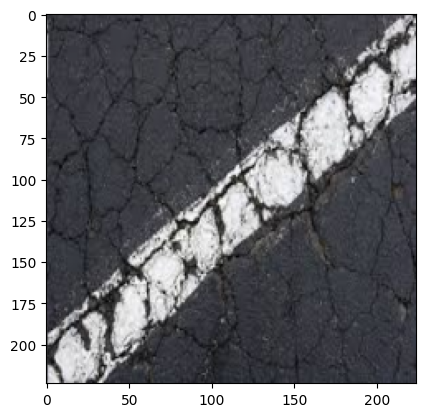

gt label: Fatigue cracks
prediction: Linear cracks


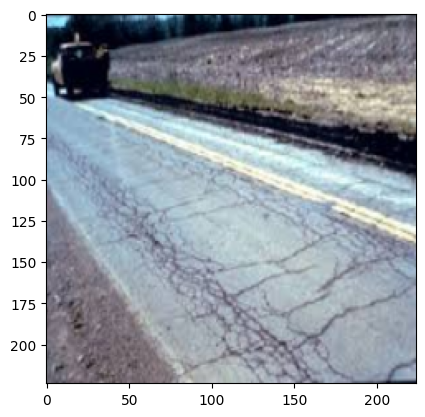

gt label: Linear cracks
prediction: Potholes


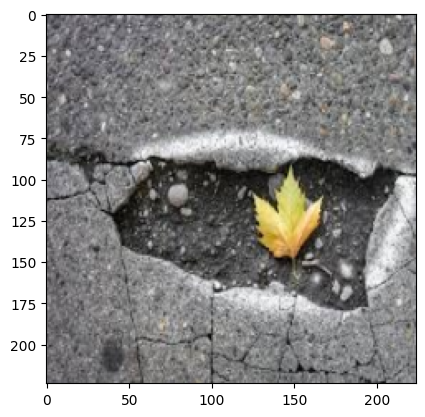

gt label: Fatigue cracks
prediction: Linear cracks


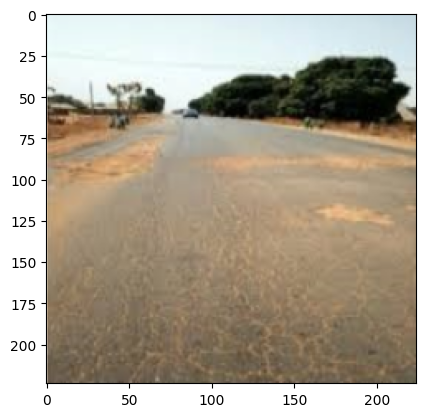

gt label: Linear cracks
prediction: Fatigue cracks


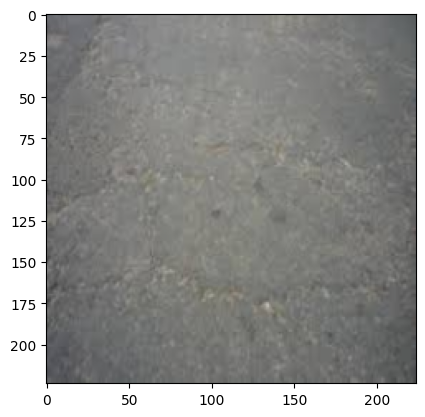

gt label: Linear cracks
prediction: Fatigue cracks


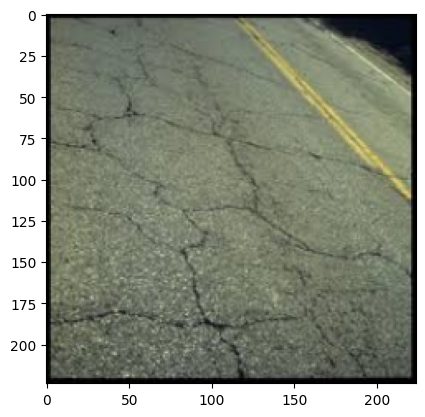

gt label: Fatigue cracks
prediction: Linear cracks


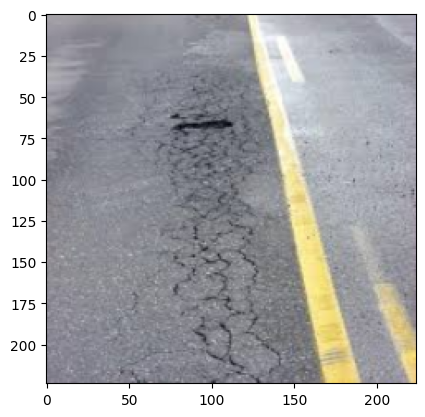

gt label: Fatigue cracks
prediction: Linear cracks


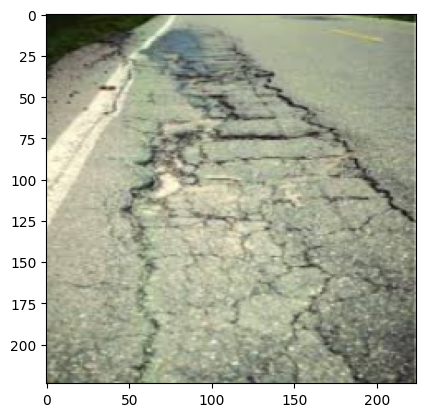

gt label: Linear cracks
prediction: Fatigue cracks


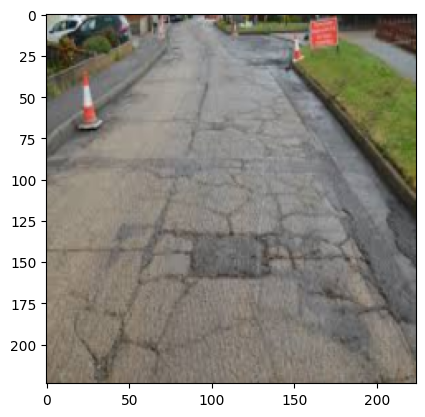

gt label: Linear cracks
prediction: Fatigue cracks


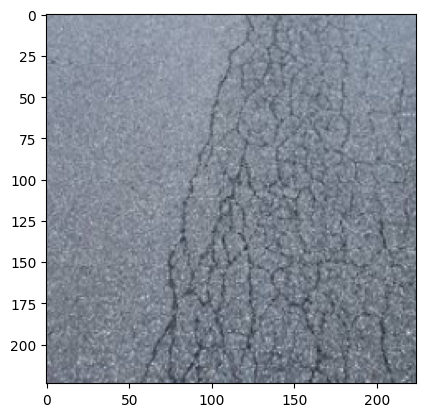

gt label: Linear cracks
prediction: Fatigue cracks


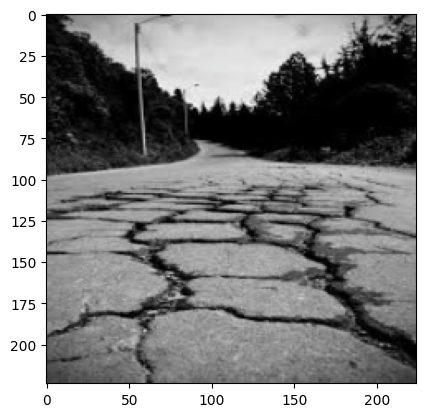

gt label: Fatigue cracks
prediction: Linear cracks


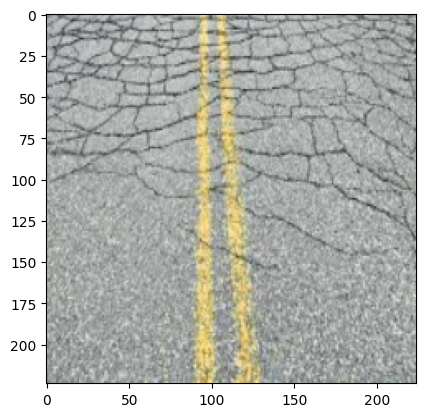

gt label: Linear cracks
prediction: Fatigue cracks


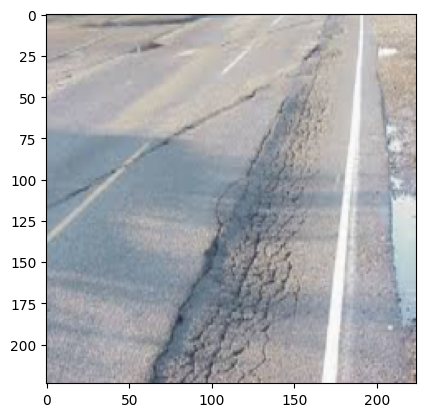

gt label: Linear cracks
prediction: Fatigue cracks


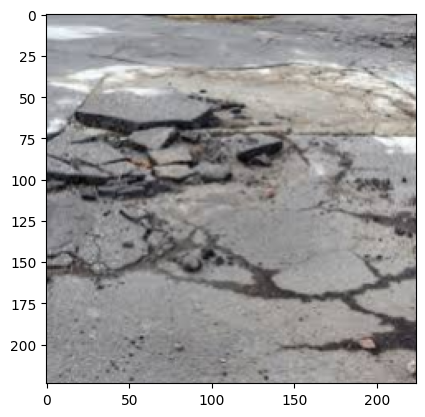

gt label: Fatigue cracks
prediction: Linear cracks


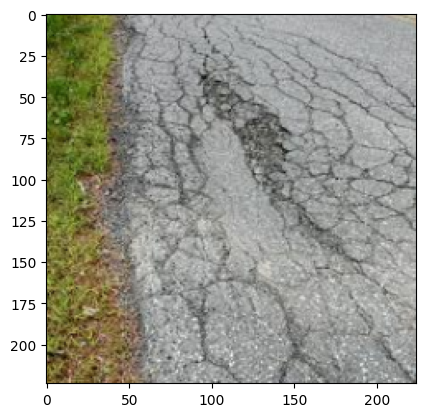

gt label: Linear cracks
prediction: Fatigue cracks


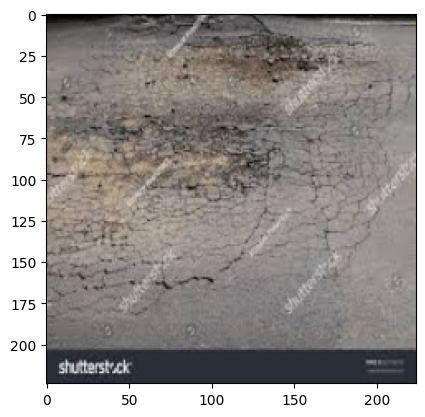

gt label: Linear cracks
prediction: Fatigue cracks


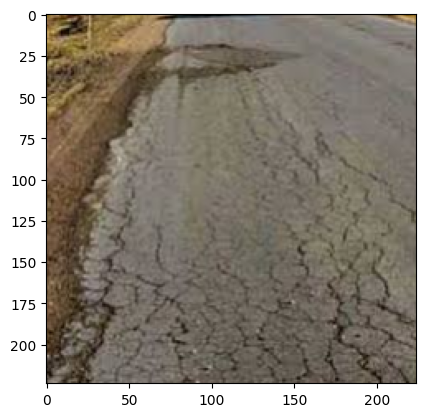

gt label: Fatigue cracks
prediction: Linear cracks


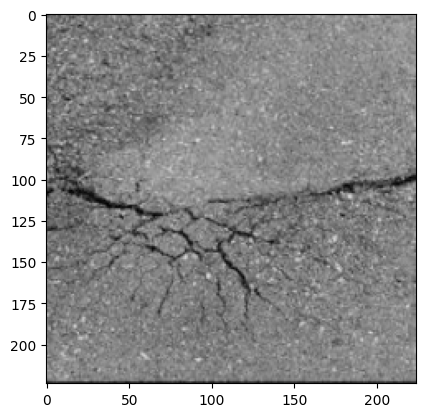

gt label: Fatigue cracks
prediction: Linear cracks


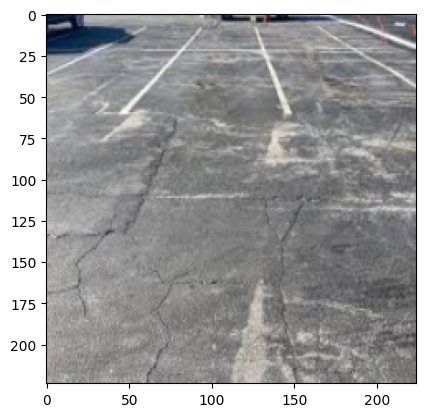

gt label: Fatigue cracks
prediction: Linear cracks


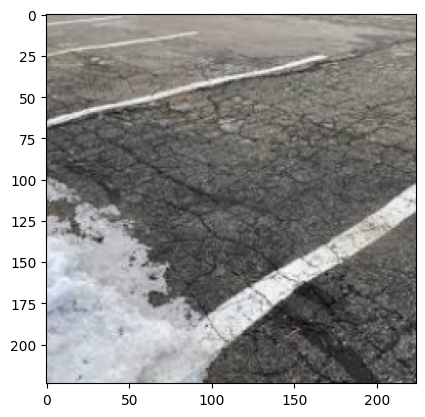

gt label: Fatigue cracks
prediction: Potholes


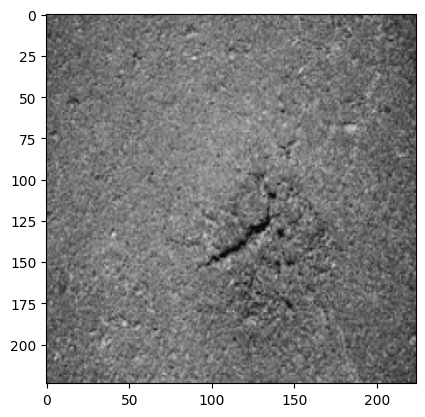

gt label: Fatigue cracks
prediction: Linear cracks


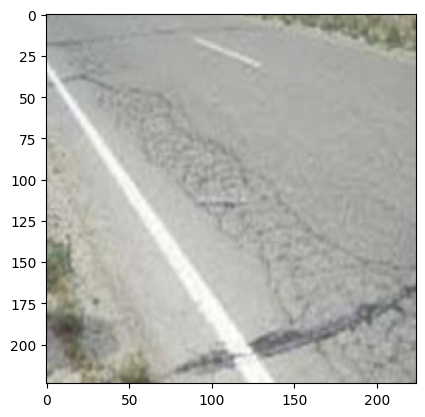

gt label: Linear cracks
prediction: Fatigue cracks


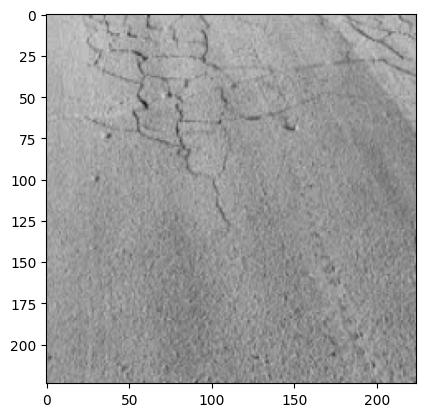

gt label: Fatigue cracks
prediction: Linear cracks


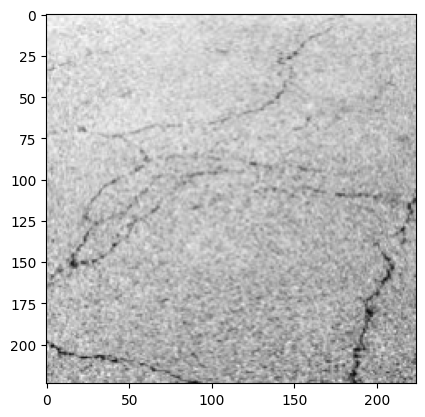

gt label: Fatigue cracks
prediction: Linear cracks


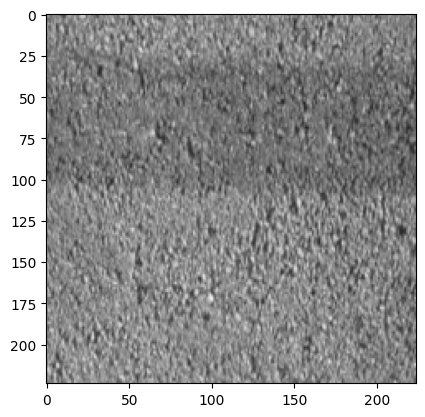

gt label: Fatigue cracks
prediction: Linear cracks


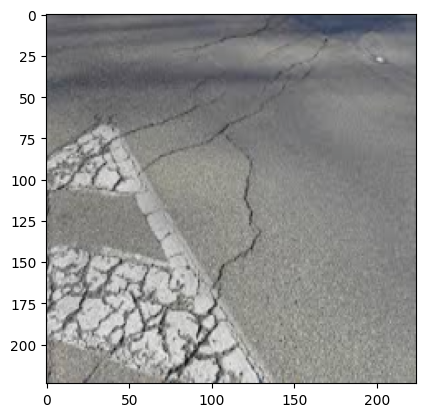

gt label: Fatigue cracks
prediction: Linear cracks


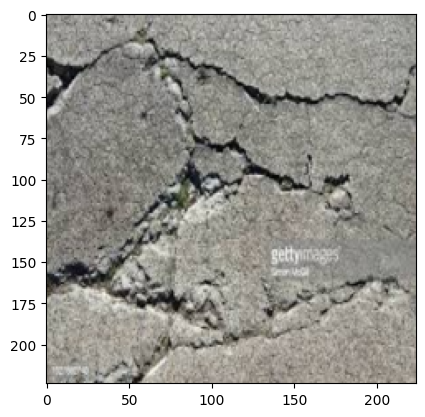

gt label: Fatigue cracks
prediction: Linear cracks


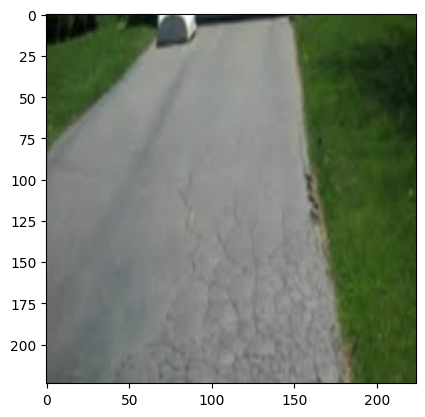

gt label: Linear cracks
prediction: Fatigue cracks


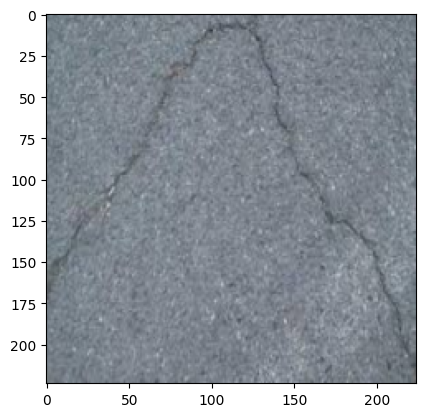

In [34]:
error_images = check_accuracy(dataloaders['Validation'], model_ft, device)

error_examples = visualize_test_errors(dataloaders['Validation'], model_ft, device)
#shows some prediction errors. Might show nothing if prediction is 100%
visualize_error_images(error_examples)

In [ ]:
dfvgbhjnkml,;

# Model Saving

In [ ]:
torch.save(model_ft, 'model-APD-pytorch-res50-92accuracy.pt')